## 臉部偵測與辨識

In [1]:
# 起手式
import sys,  time
import ipywidgets as widget
from ipywidgets import interact
from IPython.display import display
import numpy as np
import cv2
from PIL import Image
from io import BytesIO
def to_pil(ima):
    if ima.dtype == np.float64:
        ima = (ima*255).clip(0,255).astype('uint8')
    return Image.fromarray(ima)
    
def img_to_png(ima, cvt=None):
    if cvt:
        ima = cv2.cvtColor(ima, cvt)
    im = to_pil(ima)
    bio = BytesIO()
    im.save(bio, format='png')
    return bio.getvalue()

In [2]:
# 讀取已經學習過的臉部以及眼睛偵測 haar cascade
face_cascade = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_default.xml')
eye_cascade = cv2.CascadeClassifier('haarcascades/haarcascade_eye.xml')

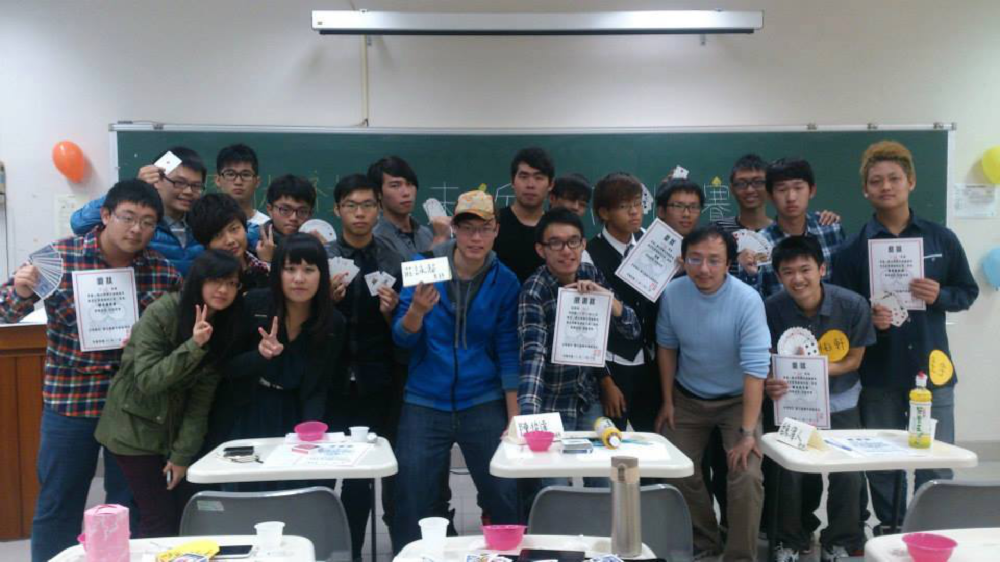

In [3]:
# 東華魔術社近距離比賽照片
img = Image.open("img/magic_faces.jpg")
# 轉成陣列
img = np.array(img)
# 放大兩倍，比較好找
img = cv2.resize(img, (img.shape[1]*2, img.shape[0]*2))
# 灰階圖
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
# 顯示
to_pil(img)

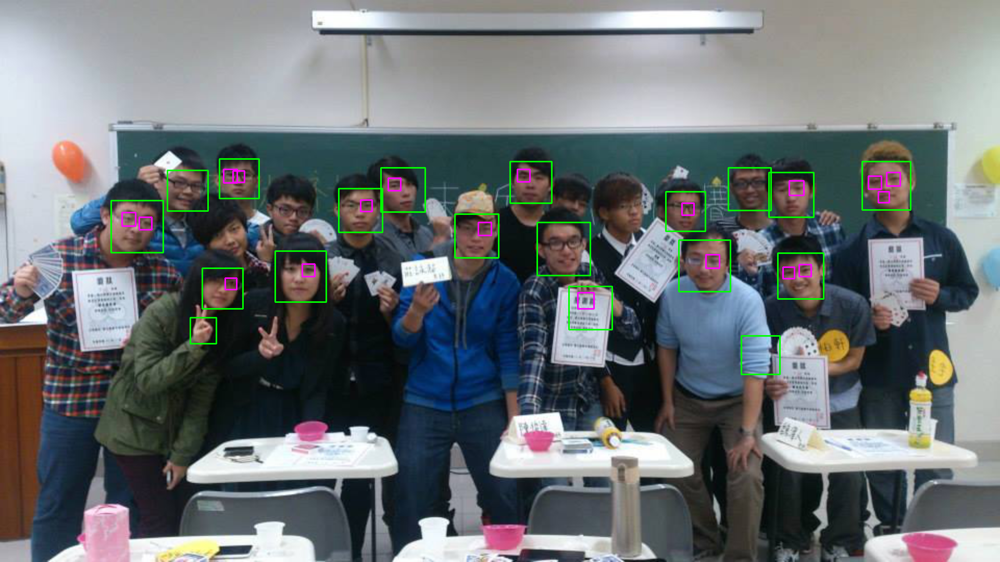

In [4]:
# 從裡面來找找看臉吧
faces = face_cascade.detectMultiScale(gray, 1.1, 5)
# 從每個找到的裡面，再去找眼睛
for (x,y,w,h) in faces:
    # 畫綠色的長方形
    cv2.rectangle(img,(x,y),(x+w,y+h),(0,255,0),2)
    # 專注在臉部的小長方形圖
    roi_gray = gray[y:y+h, x:x+w]
    roi_color = img[y:y+h, x:x+w]
    # 從小長方形灰階圖中間去找眼睛
    eyes = eye_cascade.detectMultiScale(roi_gray)
    # 畫出眼睛的方塊
    for (ex,ey,ew,eh) in eyes:
        cv2.rectangle(roi_color,(ex,ey),(ex+ew,ey+eh),(255,0,255),2)
to_pil(img)

In [5]:
# 另外一種臉部偵測方式，使用 dlib
import dlib
fd = dlib.get_frontal_face_detector()


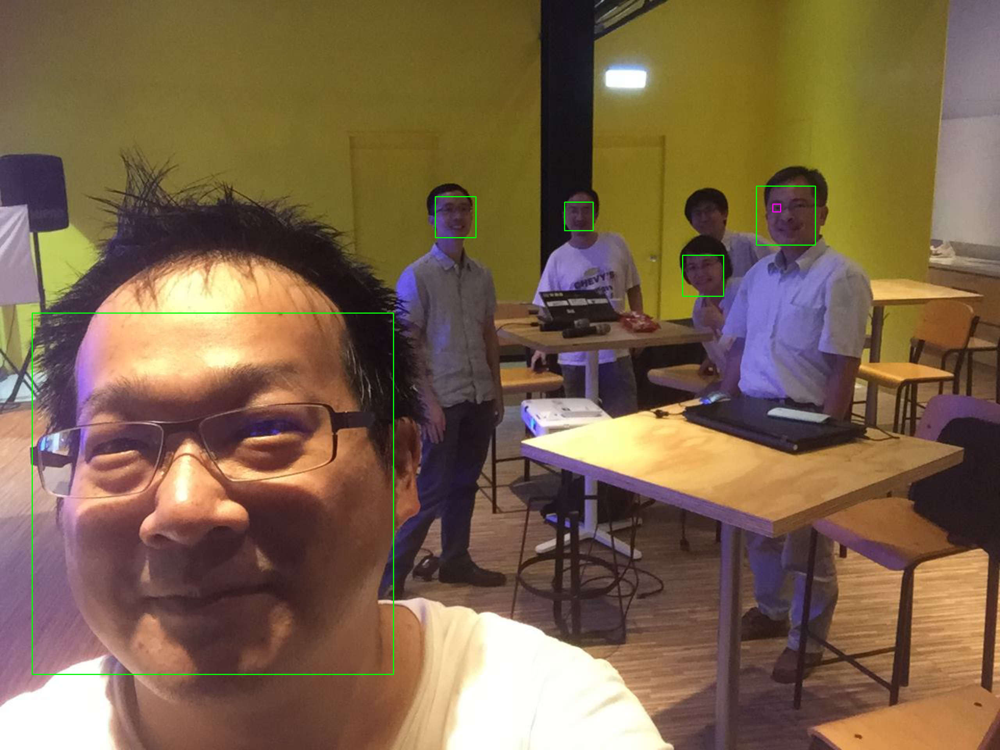

In [6]:
def find_faces(fn):
    img = Image.open(fn)
    img = np.array(img)
    img = cv2.resize(img, (img.shape[1]*2, img.shape[0]*2))
    #img = cv2.resize(img, (200,400))
    rl = fd(img)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    #faces = face_cascade.detectMultiScale(gray, 1.1, 5, minSize=(5,5), maxSize=(1000,1000))
    #for (x,y,w,h) in faces:
    for r in rl:
        x,y,w,h = r.left(), r.top(), r.width(), r.height()
        cv2.rectangle(img,(x,y),(x+w,y+h),(0,255,0),2)
        roi_gray = gray[y:y+h, x:x+w]
        roi_color = img[y:y+h, x:x+w]
        eyes = eye_cascade.detectMultiScale(roi_gray)
        for (ex,ey,ew,eh) in eyes:
            cv2.rectangle(roi_color,(ex,ey),(ex+ew,ey+eh),(255,0,255),2)
    return to_pil(img)
find_faces("img/py_faces.jpg")

# Photo files from https://www.flickr.com/photos/76636751@N06/albums

In [7]:
 #!unzip x zipfile
#!ls

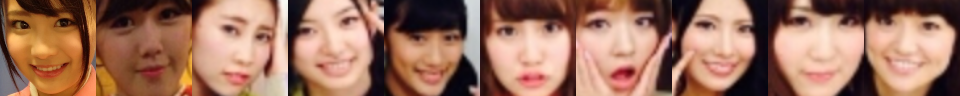

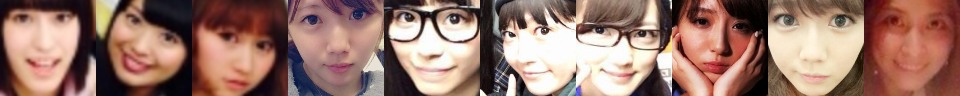

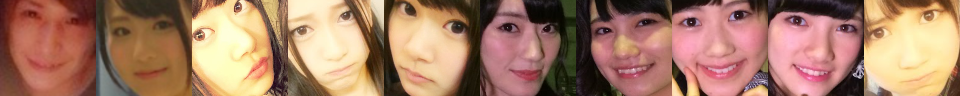

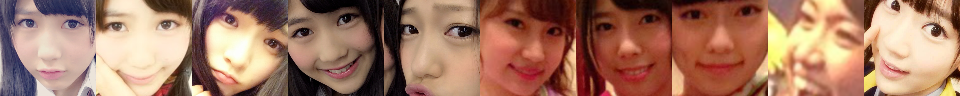

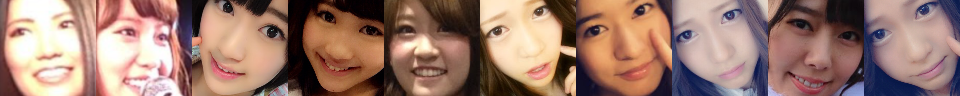

...

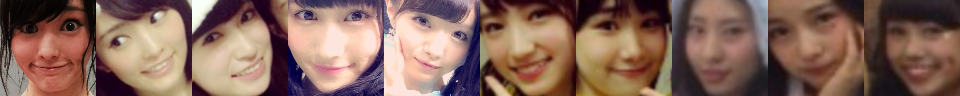

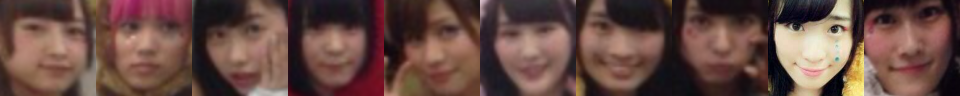

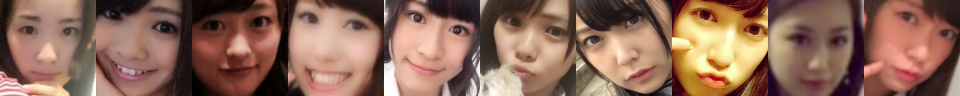

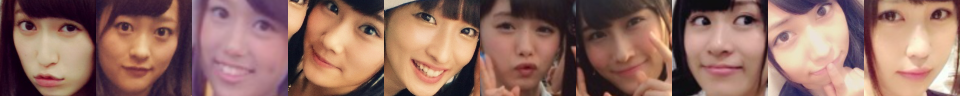

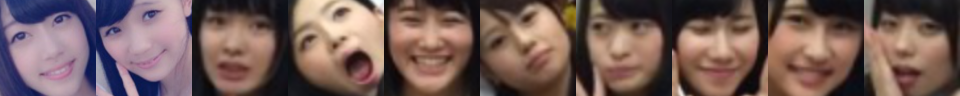

In [8]:
import glob
color_faces = []
gray_faces = []
for fn in glob.glob("akb48/*.jpg"):
    img = Image.open(fn)
    img = np.array(img)
    img0 = img = cv2.resize(img, (img.shape[1]*2, img.shape[0]*2))
    #rows,cols = img0.shape[:2]
    #for deg in range(-45, 46, 45):
    #    M = cv2.getRotationMatrix2D((cols/2,rows/2),deg,1)
    #    img = cv2.warpAffine(img0,M,(cols,rows))
    if 1:
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        #faces = face_cascade.detectMultiScale(gray, 1.3, 5)
        #for (x,y,w,h) in faces:
        rl = fd(img)
        for r in rl:
            x,y,w,h = r.left(), r.top(), r.width(), r.height()
            if x<0 or y <0:
                continue
            roi_color = cv2.resize(img[y:y+h, x:x+w], (96,96))
            roi_gray = cv2.cvtColor(roi_color, cv2.COLOR_RGB2GRAY)
            roi_gray = cv2.equalizeHist(roi_gray)
            color_faces.append(roi_color.copy())
            gray_faces.append(roi_gray)
            if len(color_faces)%10 == 0:
                out_img = np.concatenate(color_faces[-10:], axis=1)
                display(to_pil(out_img))
        #display(to_pil(roi_gray))


In [9]:
idx=np.arange(len(gray_faces))
np.random.shuffle(idx)
gray_faces = np.array(gray_faces)
color_faces = np.array(color_faces)
gray_faces=gray_faces[idx]
color_faces=color_faces[idx]

In [10]:
model = cv2.face.createLBPHFaceRecognizer()

In [11]:
labels=np.arange(len(gray_faces)-100)

In [12]:
model.train(gray_faces[:-100], labels)

(419, 100.1949520111881)


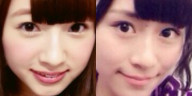

(247, 93.2611567533644)


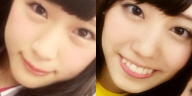

(84, 103.69551415610731)


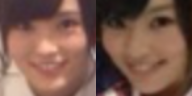

(472, 76.81106876632998)


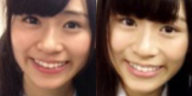

(405, 114.09069021322209)


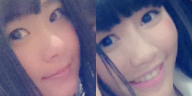

(31, 110.93170834118922)


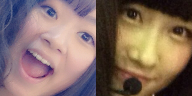

(221, 104.61817998384551)


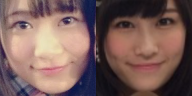

(153, 103.14804869519965)


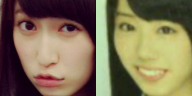

(200, 106.7701939259284)


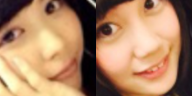

(329, 120.01533040785243)


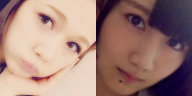

(3, 104.85239147019742)


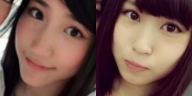

(105, 116.47520138447905)


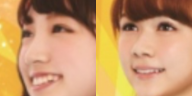

(499, 108.47020425722913)


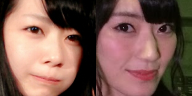

(237, 109.68568039052425)


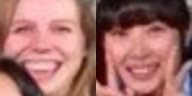

(475, 116.54178689698102)


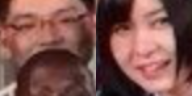

(221, 106.20879386798634)


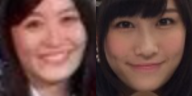

(504, 103.43964060870772)


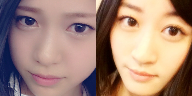

(274, 103.54132980943693)


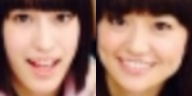

(151, 110.19532337811305)


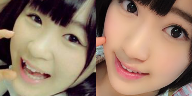

(47, 108.5855955424233)


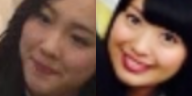

(228, 113.21205282669169)


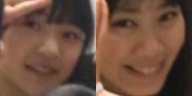

(29, 94.63399203094035)


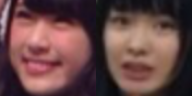

(221, 102.14938030126875)


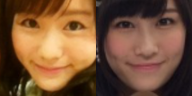

(45, 112.88544950897489)


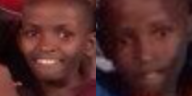

(270, 106.59481651982415)


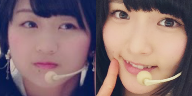

(392, 119.86136466442395)


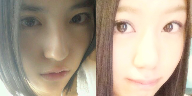

(380, 116.96663997047109)


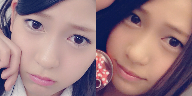

(61, 111.50182580106117)


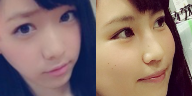

(85, 107.52028936310032)


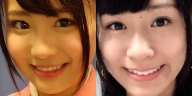

(247, 102.01867963195788)


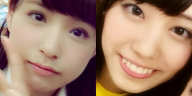

(364, 118.36656019920379)


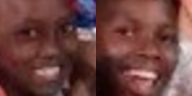

(16, 110.68795781696605)


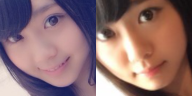

(333, 106.26572390274515)


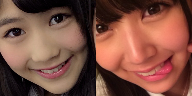

(346, 99.39269074710883)


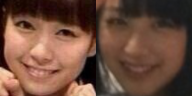

(6, 117.87411961508155)


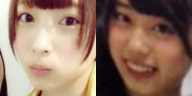

(106, 121.00782057675777)


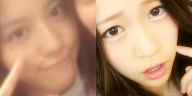

(211, 107.17598809610853)


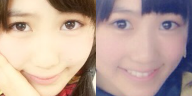

(389, 103.43937324967719)


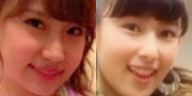

(245, 102.52332020746844)


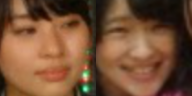

(343, 105.74721455573311)


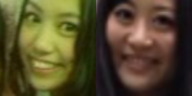

(107, 114.80987985740748)


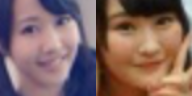

(28, 102.67348655294423)


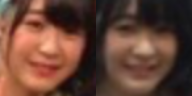

(183, 117.31790401217397)


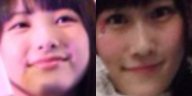

(281, 89.33457922986477)


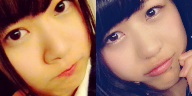

(157, 109.74048838361323)


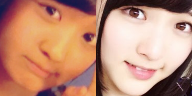

(24, 106.64207956607494)


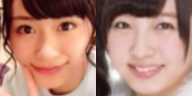

(318, 105.26847476106603)


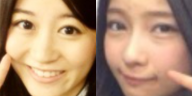

(396, 121.16582754053704)


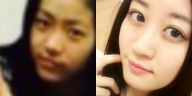

(111, 107.26877564988673)


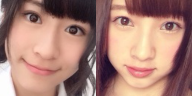

(190, 98.28854747606795)


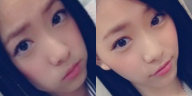

(270, 97.74918246167881)


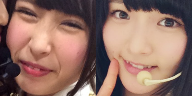

(6, 103.90572230365255)


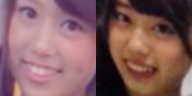

(93, 101.19911088739873)


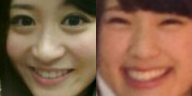

(209, 93.37444484248388)


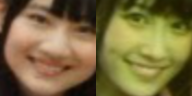

(387, 106.88998827823117)


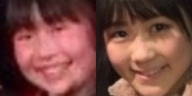

(212, 119.86040854307454)


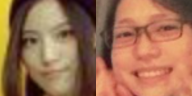

(496, 101.80127513517867)


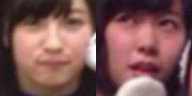

(264, 100.72020925440641)


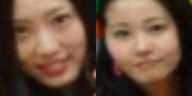

(384, 101.73024376442535)


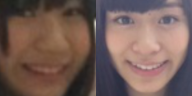

(209, 112.91792486881594)


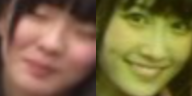

(450, 113.98033281551506)


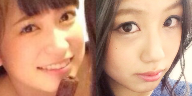

(174, 103.8275077536941)


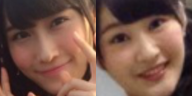

(168, 103.27430226619983)


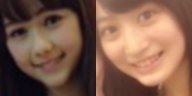

(168, 97.09774212924236)


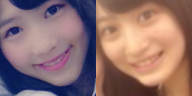

(272, 115.26132991047608)


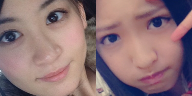

(45, 108.01727832387112)


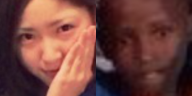

(6, 104.85624045668527)


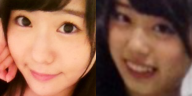

(434, 108.67727610275517)


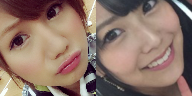

(341, 107.54333138329812)


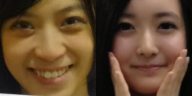

(221, 97.47552913647456)


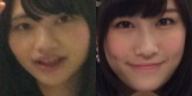

(197, 110.96829876453073)


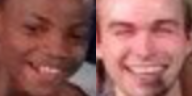

(96, 107.5186621823719)


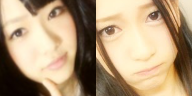

(381, 118.74910836710302)


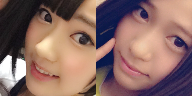

(420, 107.12653431433482)


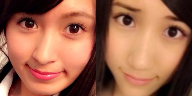

(256, 108.32948224904032)


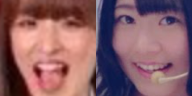

(296, 92.1972442613722)


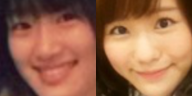

(106, 99.21558212458253)


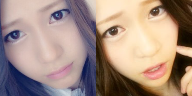

(365, 105.065430111956)


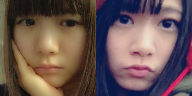

(184, 97.76299197188594)


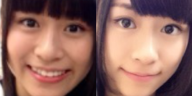

(396, 107.69945312654805)


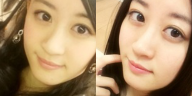

(350, 103.86431092051221)


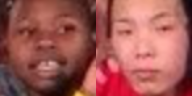

(129, 109.26867317841723)


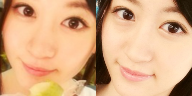

(451, 129.62072720119747)


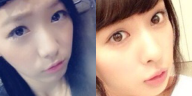

(310, 105.21532028843193)


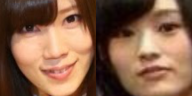

(299, 112.44701282580617)


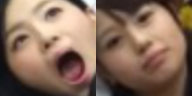

(368, 111.17814359006412)


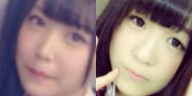

(149, 110.03704185814539)


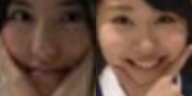

(194, 103.50593837102757)


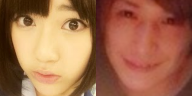

(102, 107.8119303988206)


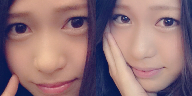

(499, 122.41956109634258)


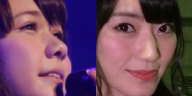

(260, 96.71041484889457)


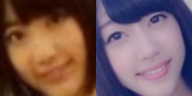

(238, 101.08228872881628)


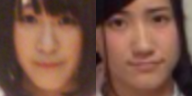

(184, 109.8525673285308)


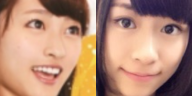

(11, 106.84049784392896)


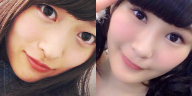

(200, 94.8672852347177)


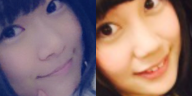

(117, 107.30523966949693)


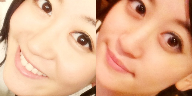

(85, 108.45798309099627)


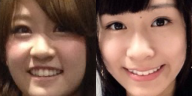

(251, 110.03608453265586)


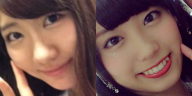

(415, 98.04820879943674)


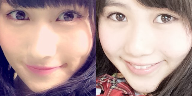

(462, 105.51415746572265)


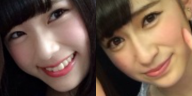

In [13]:
for i in range(100):
    r = model.predict(gray_faces[-i-1])
    print(r)
    img1 = color_faces[-i-1]
    img2 = color_faces[r[0]]
    display(to_pil(np.concatenate([img1, img2], axis=1)))